In [2]:
# Import the necessary libraries and modules

!pip install torch_snippets torch_summary --quiet
!pip install torchvision
import itertools
from PIL import Image
from torch_snippets import *
from torchvision import transforms
from torchvision.utils import make_grid
from torchsummary import summary


In [3]:
# Mount Google Drive to access the dataset

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
%cd /content/drive/My Drive/HW_06 Dataset

/content/drive/My Drive/HW_06 Dataset


In [5]:
# Load a sample image and check its size

img = Image.open('trainA/00001.jpg')
img.size

(256, 256)

In [6]:
# Define image transformation pipeline (image augmentation)

IMAGE_SIZE = 256
device = 'cuda' if torch.cuda.is_available() else 'cpu'
transform = transforms.Compose([
    transforms.Resize(int(IMAGE_SIZE*1.33)),
    transforms.RandomCrop((IMAGE_SIZE,IMAGE_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])


In [7]:
# Create a custom dataset for Monet-to-photo translation with up to 100 images

class MonetToPhoto(Dataset):
    def __init__(self, monet_images, photo_images):
        # Initialize with paths to Monet and photo images
        all_monet = Glob(monet_images)
        all_photo = Glob(photo_images)
        self.monet_images = random.sample(all_monet, min(100, len(all_monet)))  
        self.photo_images = random.sample(all_photo, min(100, len(all_photo)))   

    def __getitem__(self, ix):
        # Get Monet and photo image pairs at index ix
        monet_image = self.monet_images[ix % len(self.monet_images)]
        photo_image = self.photo_images[ix % len(self.photo_images)]
        monet_image = Image.open(monet_image).convert('RGB')
        photo_image = Image.open(photo_image).convert('RGB')
        return monet_image, photo_image

    def __len__(self):
        # Return the length of the dataset
        return max(len(self.monet_images), len(self.photo_images))

    def collate_fn(self, batch):
        # Collate function to process batches of Monet and photo images
        monet_images, photo_images = list(zip(*batch))
        monet_images = torch.cat([transform(img)[None] for img in monet_images], 0).to(device).float()
        photo_images = torch.cat([transform(img)[None] for img in photo_images], 0).to(device).float()
        return monet_images, photo_images



In [8]:
# Initialize DataLoader for training and validation datasets

import random

trn_ds = MonetToPhoto('trainA', 'trainB')
val_ds = MonetToPhoto('testA', 'testB')

trn_dl = DataLoader(trn_ds, batch_size=1, shuffle=True, collate_fn=trn_ds.collate_fn)
val_dl = DataLoader(val_ds, batch_size=5, shuffle=True, collate_fn=val_ds.collate_fn)


In [9]:
# Weight initialization for convolutional layers

def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, "bias") and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)


In [10]:
# Define the Residual Block used in the generator

class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
        )

    def forward(self, x):
        return x + self.block(x)

In [11]:
# Generator network definition using ResNet blocks

class GeneratorResNet(nn.Module):
    def __init__(self, num_residual_blocks=9):
        super(GeneratorResNet, self).__init__()
        out_features = 64
        channels = 3
        # Initial layer
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(channels, out_features, 7),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(inplace=True),
        ]
        in_features = out_features
        # Downsampling
        for _ in range(2):
            out_features *= 2
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Residual blocks
        for _ in range(num_residual_blocks):
            model += [ResidualBlock(out_features)]

        # Upsampling
        for _ in range(2):
            out_features //= 2
            model += [
                nn.Upsample(scale_factor=2),
                nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Output layer
        model += [nn.ReflectionPad2d(channels), nn.Conv2d(out_features, channels, 7), nn.Tanh()]
        self.model = nn.Sequential(*model)
        self.apply(weights_init_normal)
        
    def forward(self, x):
        # Forward pass of the generator
        return self.model(x)

In [12]:
# Discriminator network definition

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        channels, height, width = 3, IMAGE_SIZE, IMAGE_SIZE

        def discriminator_block(in_filters, out_filters, normalize=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers
        # Discriminator architecture
        self.model = nn.Sequential(
            *discriminator_block(channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )
        self.apply(weights_init_normal)

    def forward(self, img):
        # Forward pass of the discriminator
        return self.model(img)

In [13]:
# Generate sample images from the validation set using CycleGAN

@torch.no_grad()
def generate_sample():
    data = next(iter(val_dl))  # Get a batch of data
    G_AB.eval()
    G_BA.eval()

    real_A, real_B = data     # Separate real Monet and photo images
    fake_B = G_AB(real_A)     # Generate fake photos from Monet images
    fake_A = G_BA(real_B)     # Generate fake Monet images from photos
    
    # Arange images along x-axis
    real_A = make_grid(real_A, nrow=5, normalize=True)
    real_B = make_grid(real_B, nrow=5, normalize=True)
    fake_A = make_grid(fake_A, nrow=5, normalize=True)
    fake_B = make_grid(fake_B, nrow=5, normalize=True)
    
    # Arrange images along y-axis
    image_grid = torch.cat((real_A, fake_B, real_B, fake_A), 1)
    show(image_grid.detach().cpu().permute(1,2,0).numpy(), sz=12)   #Display the images

In [14]:
# Defining the Generator training steps

def generator_train_step(Gs, optimizer, real_A, real_B):
    G_AB, G_BA = Gs
    optimizer.zero_grad()
    loss_id_A = criterion_identity(G_BA(real_A), real_A)
    loss_id_B = criterion_identity(G_AB(real_B), real_B)

    loss_identity = (loss_id_A + loss_id_B) / 2
    fake_B = G_AB(real_A)
    loss_GAN_AB = criterion_GAN(D_B(fake_B), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))
    fake_A = G_BA(real_B)
    loss_GAN_BA = criterion_GAN(D_A(fake_A), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))

    loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2
    recov_A = G_BA(fake_B)
    loss_cycle_A = criterion_cycle(recov_A, real_A)
    recov_B = G_AB(fake_A)
    loss_cycle_B = criterion_cycle(recov_B, real_B)

    loss_cycle = (loss_cycle_A + loss_cycle_B) / 2
    loss_G = loss_GAN + lambda_cyc * loss_cycle + lambda_id * loss_identity
    loss_G.backward()
    optimizer.step()
    return loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B

In [15]:
# Defining the Discriminator training steps

def discriminator_train_step(D, real_data, fake_data, optimizer):
    optimizer.zero_grad()
    loss_real = criterion_GAN(D(real_data), torch.Tensor(np.ones((len(real_data), 1, 16, 16))).to(device))
    loss_fake = criterion_GAN(D(fake_data.detach()), torch.Tensor(np.zeros((len(real_data), 1, 16, 16))).to(device))
    loss_D = (loss_real + loss_fake) / 2
    loss_D.backward()
    optimizer.step()
    return loss_D


In [16]:
# Setting up the CycleGAN model including generators, discriminators, loss functions, and optimizers

G_AB = GeneratorResNet().to(device)
G_BA = GeneratorResNet().to(device)
D_A = Discriminator().to(device)
D_B = Discriminator().to(device)

criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

optimizer_G = torch.optim.Adam(
    itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=0.0002, betas=(0.5, 0.999)
)
optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

lambda_cyc, lambda_id = 10.0, 5.0

EPOCH: 1.000  loss_D: 0.322  loss_G: 4.874  loss_GAN: 0.359  loss_cycle: 0.309  loss_identity: 0.285  (129.96s - 1819.41s remaining)

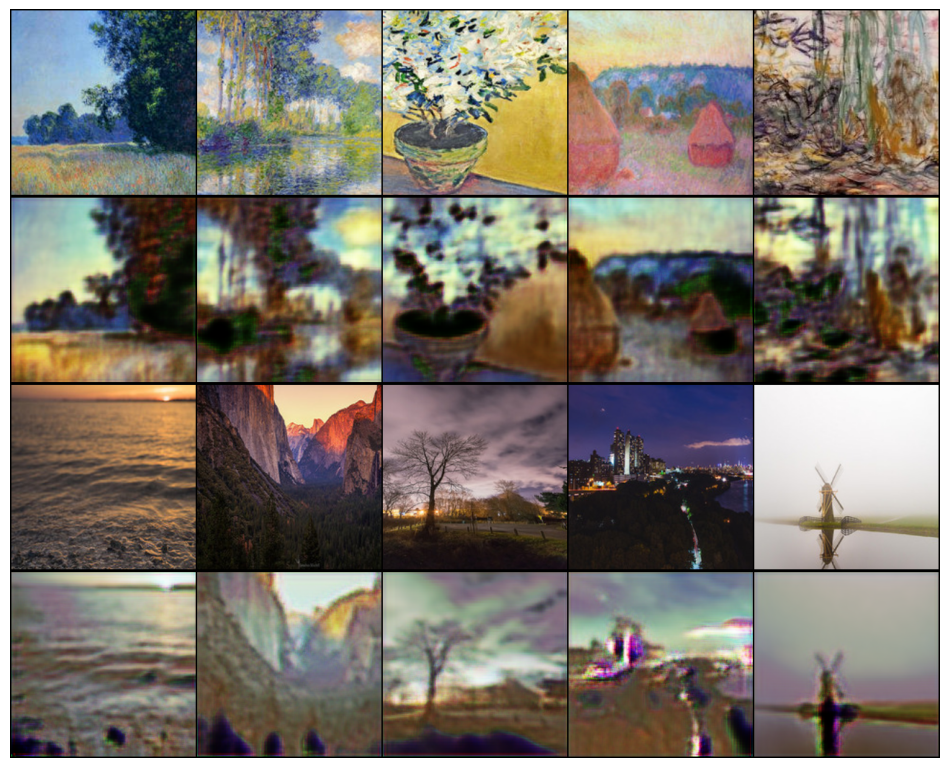

EPOCH: 1.000  loss_GAN: 0.704  loss_identity: 0.323  loss_G: 5.756  loss_D: 0.705  loss_cycle: 0.344  (135.20s - 1892.83s remaining)
EPOCH: 2.000  loss_D: 0.348  loss_G: 5.688  loss_GAN: 0.338  loss_cycle: 0.355  loss_identity: 0.360  (198.29s - 1288.91s remaining)

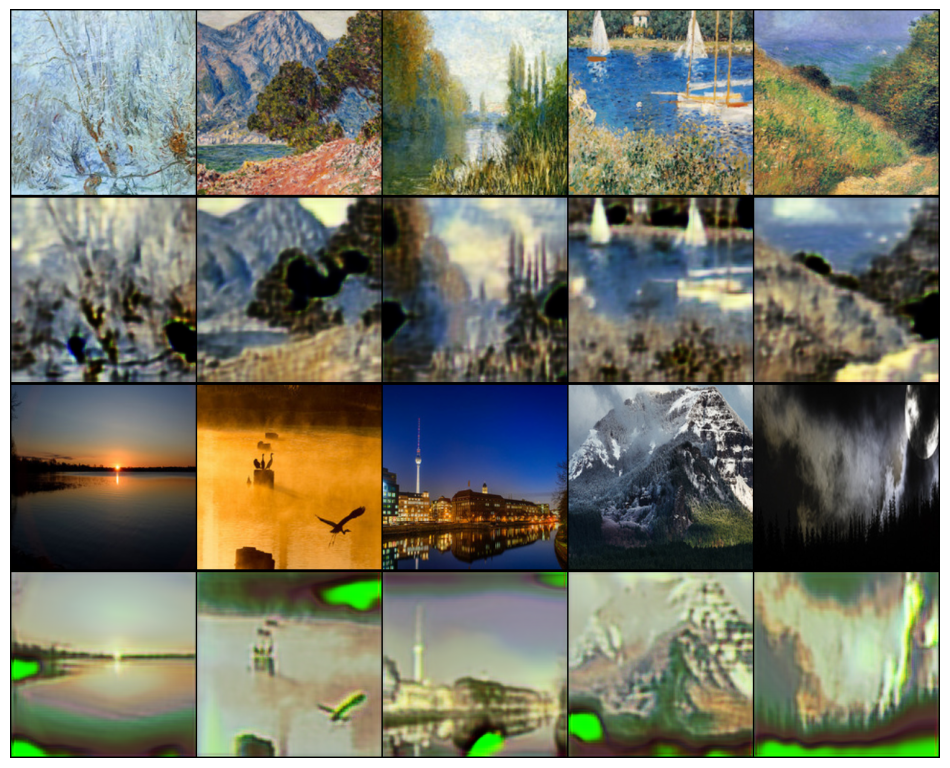

EPOCH: 2.000  loss_GAN: 0.361  loss_identity: 0.272  loss_G: 4.673  loss_D: 0.292  loss_cycle: 0.295  (203.73s - 1324.22s remaining)
EPOCH: 3.000  loss_D: 0.258  loss_G: 4.581  loss_GAN: 0.342  loss_cycle: 0.287  loss_identity: 0.274  (266.40s - 1065.60s remaining)

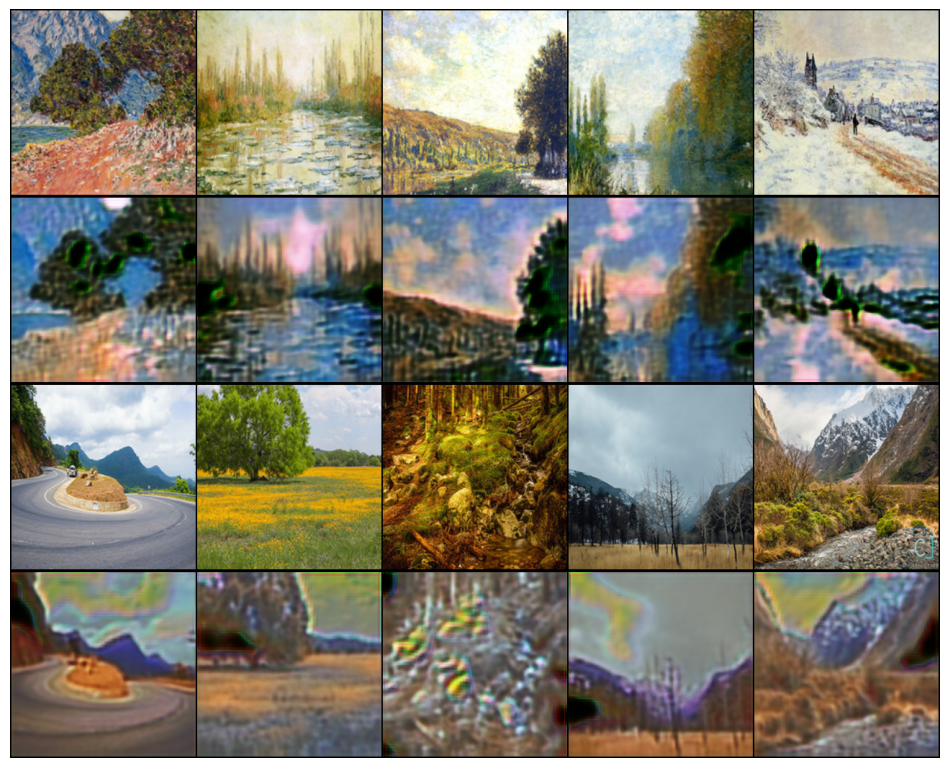

EPOCH: 3.000  loss_GAN: 0.366  loss_identity: 0.270  loss_G: 4.655  loss_D: 0.274  loss_cycle: 0.294  (271.43s - 1085.71s remaining)
EPOCH: 4.000  loss_D: 0.306  loss_G: 4.888  loss_GAN: 0.283  loss_cycle: 0.315  loss_identity: 0.290  (334.09s - 918.74s remaining)

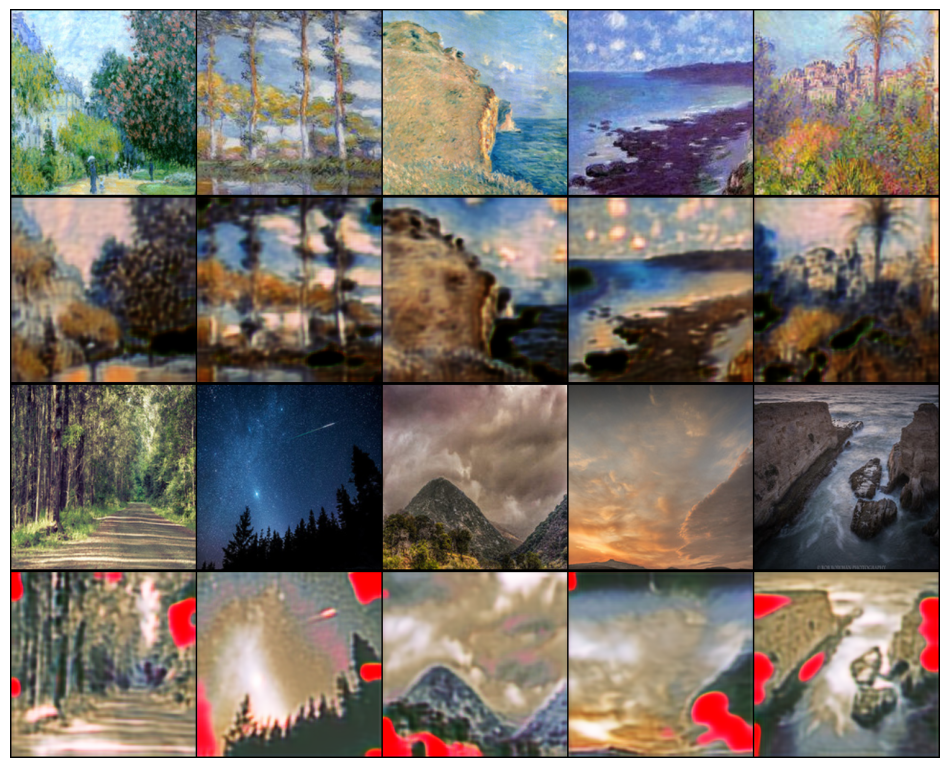

EPOCH: 4.000  loss_GAN: 0.400  loss_identity: 0.252  loss_G: 4.407  loss_D: 0.263  loss_cycle: 0.275  (339.44s - 933.46s remaining)
EPOCH: 5.000  loss_D: 0.285  loss_G: 4.655  loss_GAN: 0.298  loss_cycle: 0.302  loss_identity: 0.268  (402.14s - 804.29s remaining)

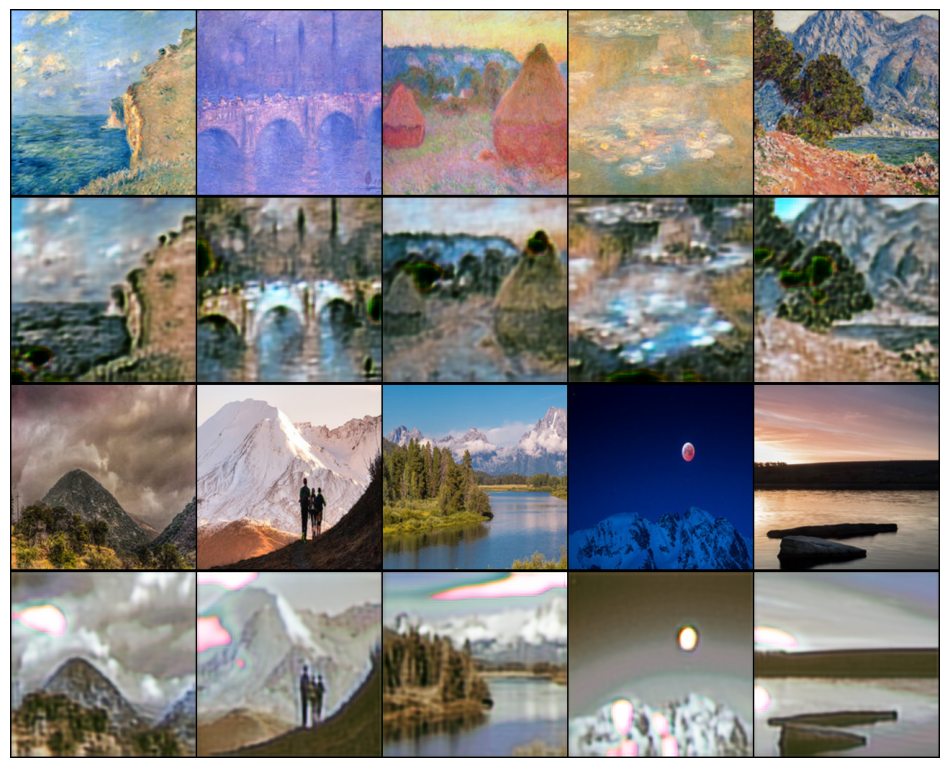

EPOCH: 5.000  loss_GAN: 0.409  loss_identity: 0.261  loss_G: 4.599  loss_D: 0.267  loss_cycle: 0.288  (406.33s - 812.67s remaining)
EPOCH: 6.000  loss_D: 0.268  loss_G: 5.531  loss_GAN: 0.399  loss_cycle: 0.353  loss_identity: 0.321  (469.01s - 703.52s remaining)

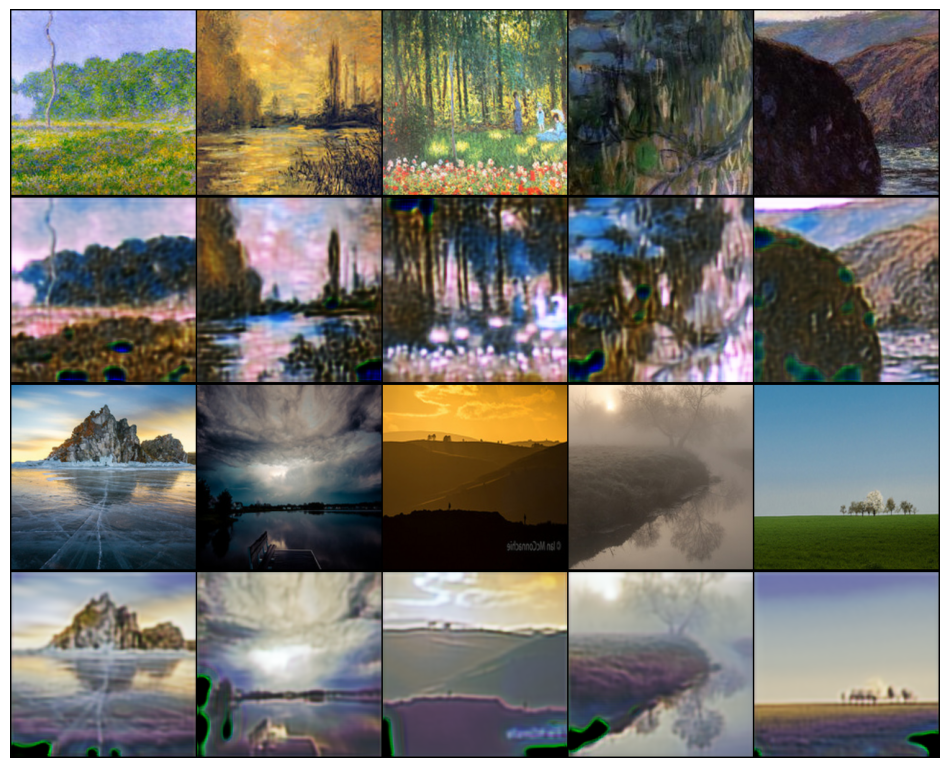

EPOCH: 6.000  loss_GAN: 0.462  loss_identity: 0.250  loss_G: 4.457  loss_D: 0.240  loss_cycle: 0.275  (474.23s - 711.34s remaining)
EPOCH: 7.000  loss_D: 0.255  loss_G: 5.188  loss_GAN: 0.464  loss_cycle: 0.327  loss_identity: 0.292  (537.01s - 613.73s remaining)

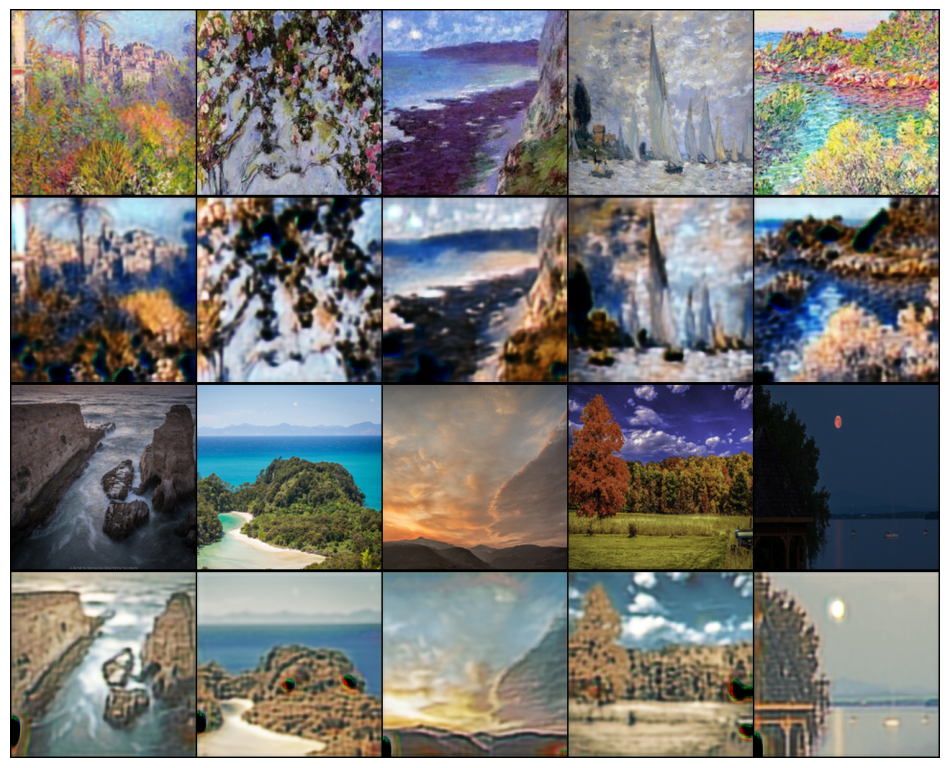

EPOCH: 7.000  loss_GAN: 0.423  loss_identity: 0.235  loss_G: 4.199  loss_D: 0.241  loss_cycle: 0.260  (540.38s - 617.57s remaining)
EPOCH: 8.000  loss_D: 0.210  loss_G: 3.554  loss_GAN: 0.384  loss_cycle: 0.211  loss_identity: 0.211  (603.06s - 527.67s remaining)

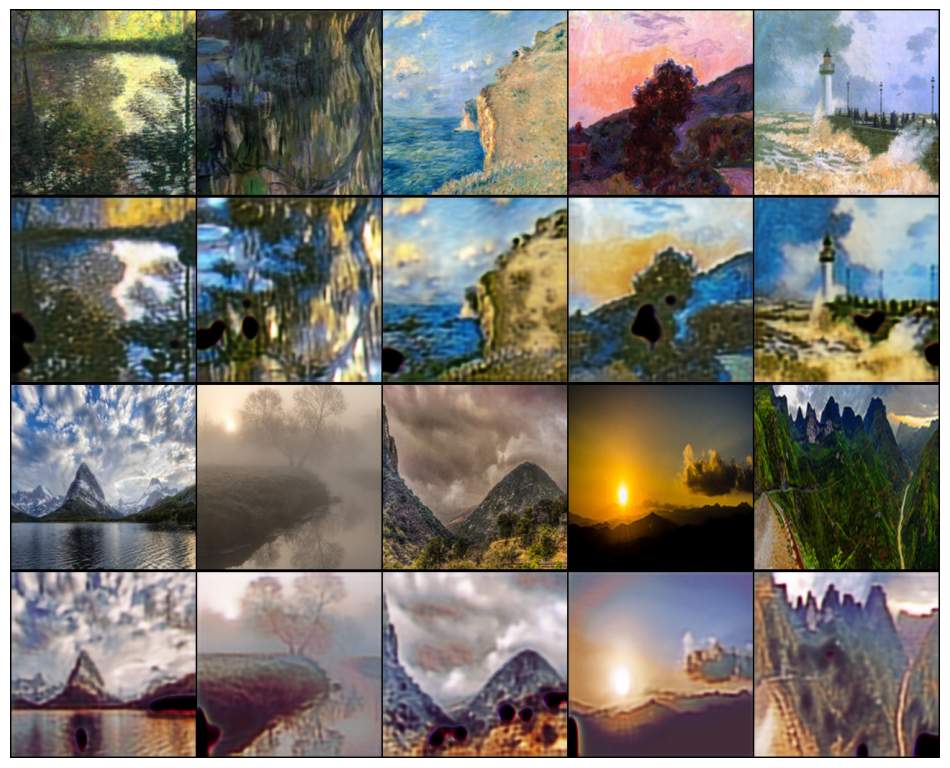

EPOCH: 8.000  loss_GAN: 0.471  loss_identity: 0.232  loss_G: 4.218  loss_D: 0.230  loss_cycle: 0.259  (606.50s - 530.69s remaining)
EPOCH: 9.000  loss_D: 0.163  loss_G: 5.394  loss_GAN: 0.325  loss_cycle: 0.340  loss_identity: 0.335  (669.19s - 446.13s remaining)

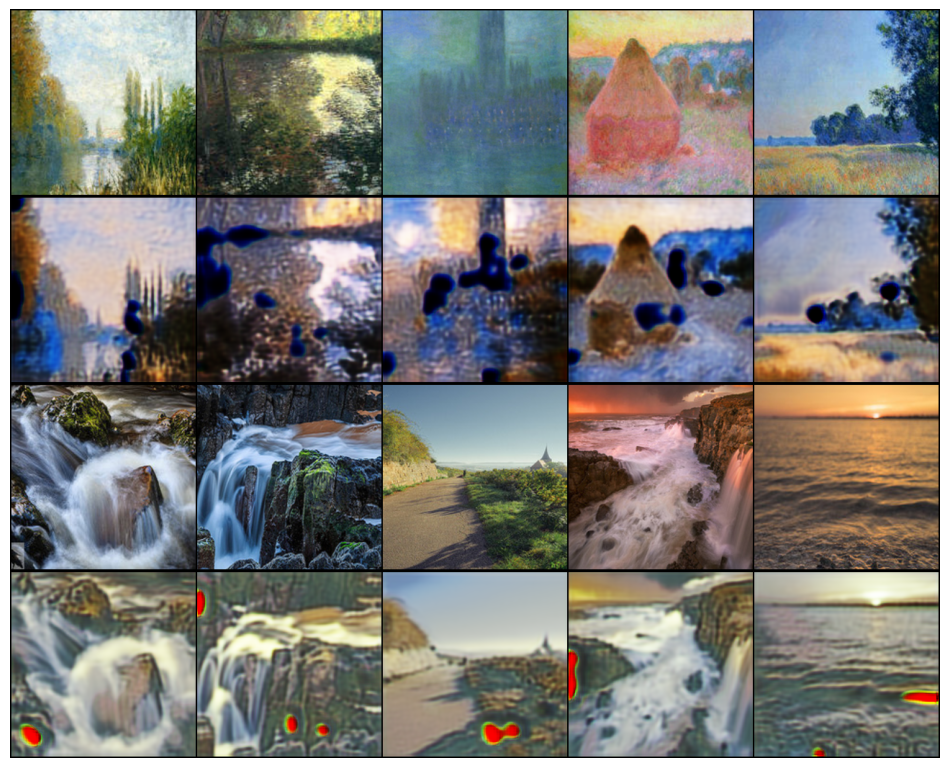

EPOCH: 9.000  loss_GAN: 0.466  loss_identity: 0.226  loss_G: 4.157  loss_D: 0.244  loss_cycle: 0.256  (673.76s - 449.17s remaining)
EPOCH: 10.000  loss_D: 0.163  loss_G: 4.169  loss_GAN: 0.432  loss_cycle: 0.256  loss_identity: 0.235  (736.40s - 368.20s remaining)

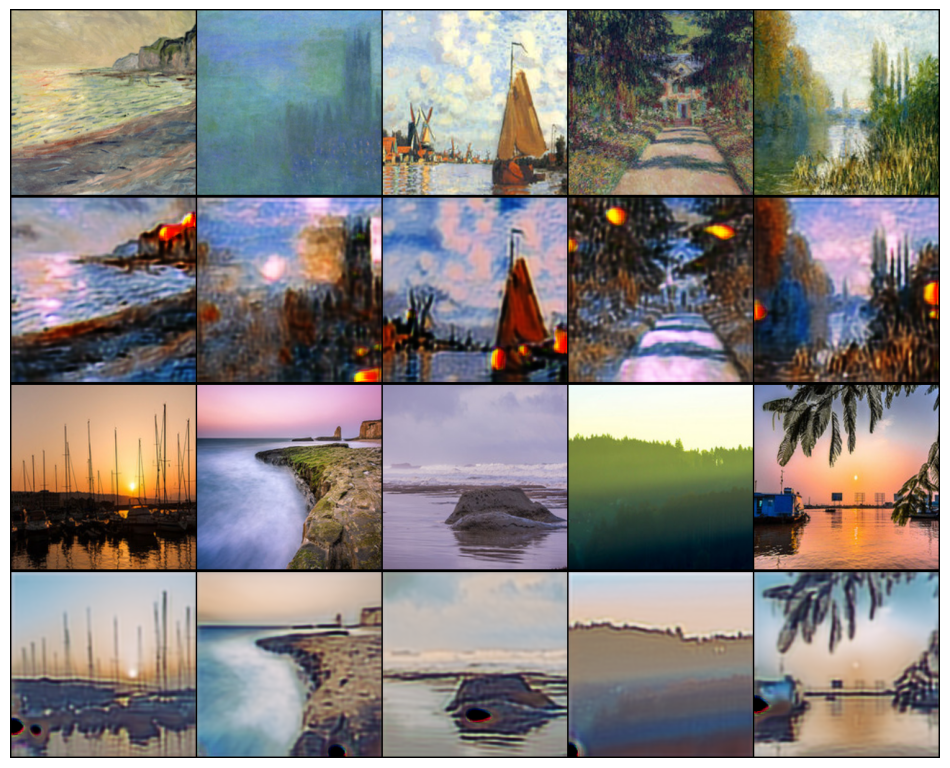

EPOCH: 10.000  loss_GAN: 0.437  loss_identity: 0.228  loss_G: 4.151  loss_D: 0.240  loss_cycle: 0.257  (741.56s - 370.78s remaining)
EPOCH: 11.000  loss_D: 0.162  loss_G: 4.122  loss_GAN: 0.554  loss_cycle: 0.231  loss_identity: 0.251  (804.30s - 292.47s remaining)

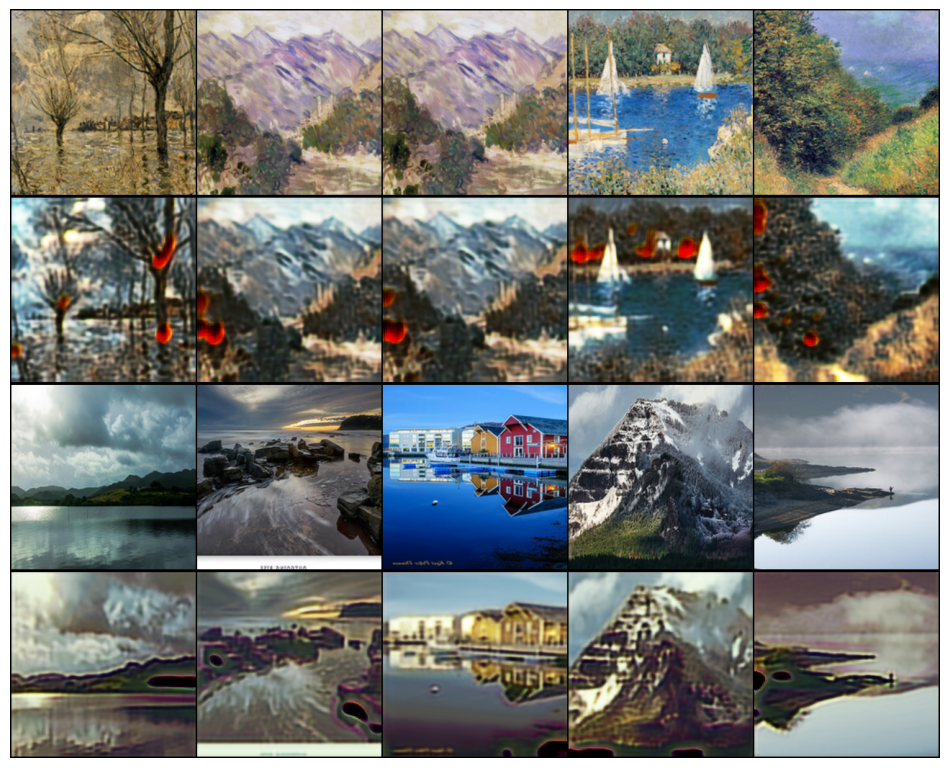

EPOCH: 11.000  loss_GAN: 0.484  loss_identity: 0.214  loss_G: 3.915  loss_D: 0.222  loss_cycle: 0.236  (808.52s - 294.01s remaining)
EPOCH: 12.000  loss_D: 0.149  loss_G: 2.844  loss_GAN: 0.560  loss_cycle: 0.154  loss_identity: 0.149  (871.23s - 217.81s remaining)

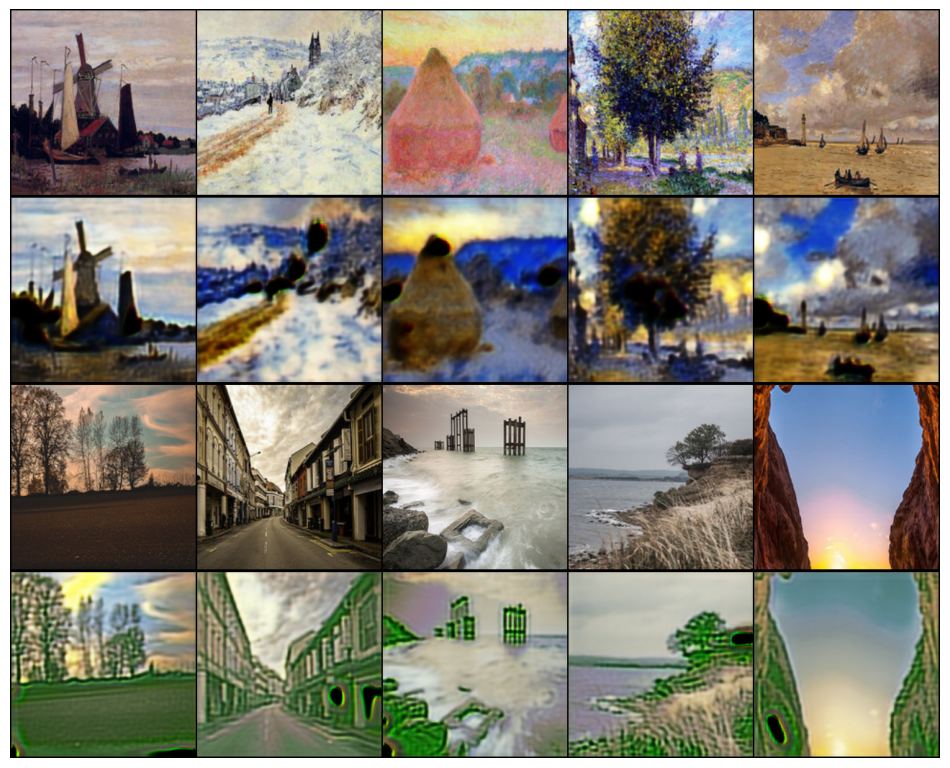

EPOCH: 12.000  loss_GAN: 0.569  loss_identity: 0.227  loss_G: 4.192  loss_D: 0.205  loss_cycle: 0.249  (876.36s - 219.09s remaining)
EPOCH: 13.000  loss_D: 0.122  loss_G: 3.235  loss_GAN: 0.479  loss_cycle: 0.180  loss_identity: 0.191  (939.17s - 144.49s remaining)

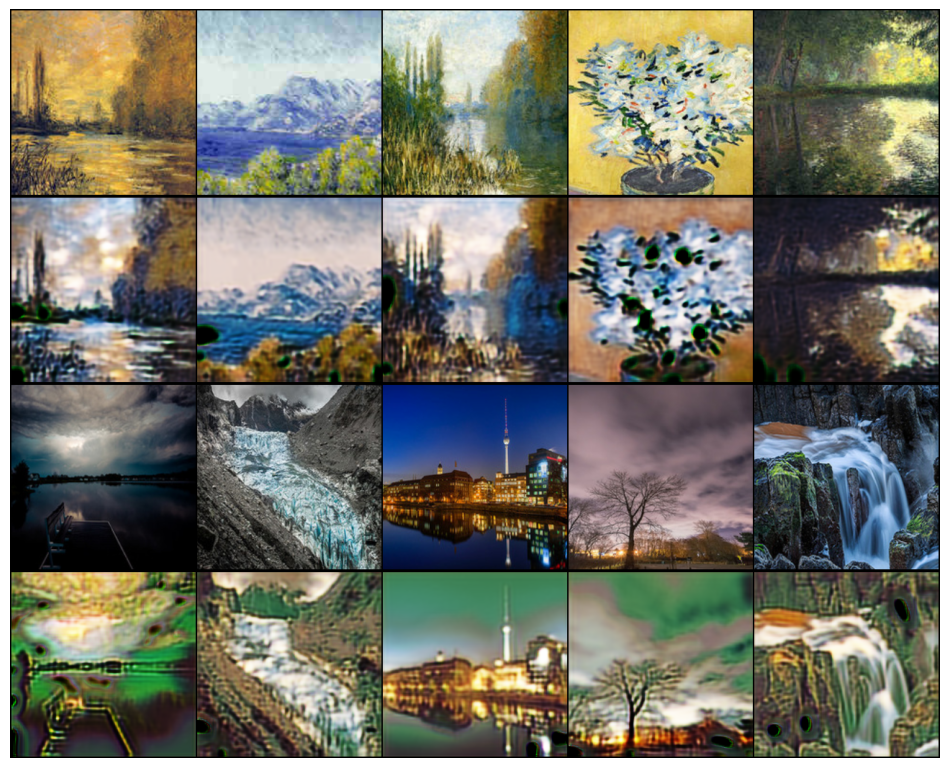

EPOCH: 13.000  loss_GAN: 0.524  loss_identity: 0.214  loss_G: 3.960  loss_D: 0.205  loss_cycle: 0.237  (941.07s - 144.78s remaining)
EPOCH: 14.000  loss_D: 0.226  loss_G: 4.215  loss_GAN: 0.521  loss_cycle: 0.260  loss_identity: 0.219  (1003.78s - 71.70s remaining)

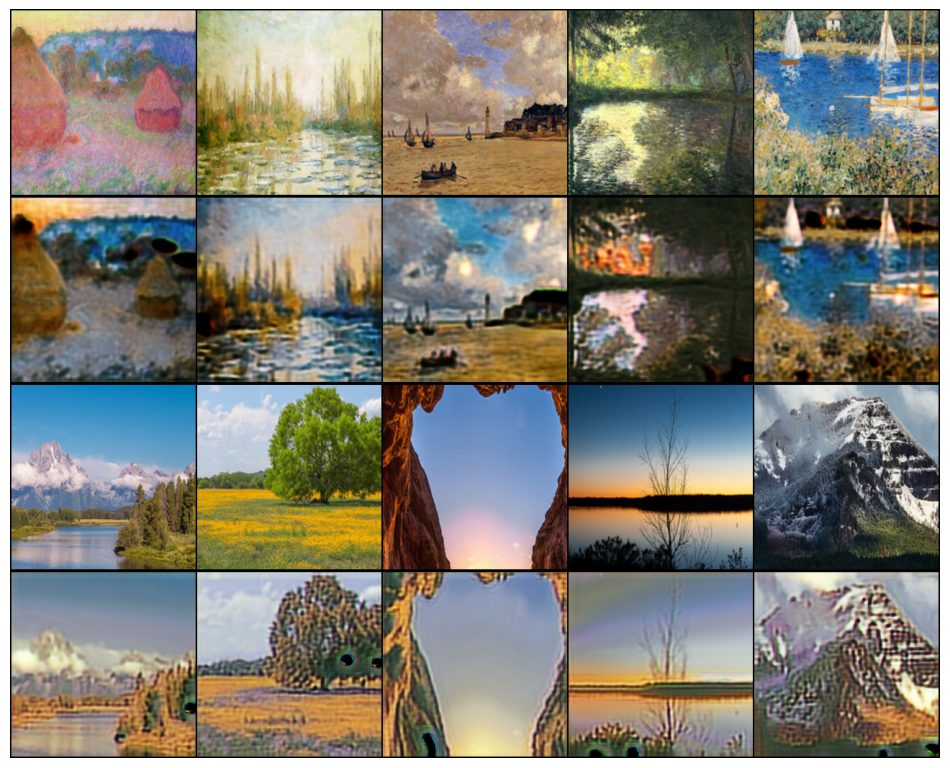

EPOCH: 14.000  loss_GAN: 0.570  loss_identity: 0.225  loss_G: 4.177  loss_D: 0.184  loss_cycle: 0.248  (1005.67s - 71.83s remaining)
EPOCH: 15.000  loss_D: 0.217  loss_G: 4.098  loss_GAN: 0.430  loss_cycle: 0.252  loss_identity: 0.230  (1068.56s - 0.00s remaining)

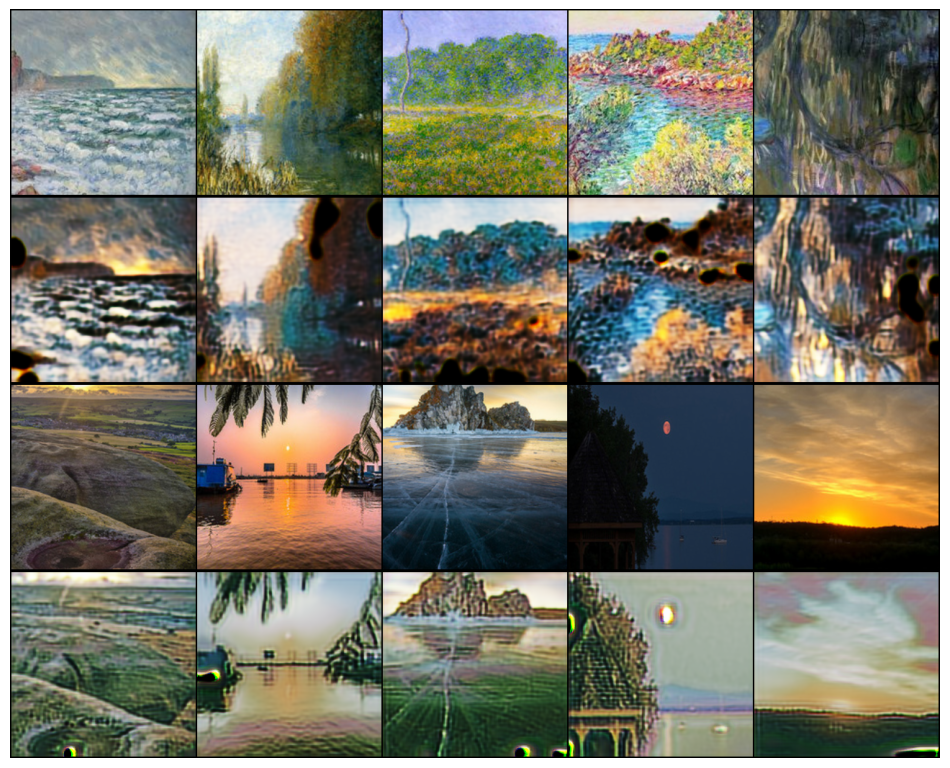

EPOCH: 15.000  loss_GAN: 0.523  loss_identity: 0.214  loss_G: 3.945  loss_D: 0.209  loss_cycle: 0.235  (1071.22s - 0.00s remaining)


In [17]:
# Train the CycleGAN for a number of epochs

n_epochs = 15
log = Report(n_epochs)
for epoch in range(n_epochs):
    N = len(trn_dl)
    for bx, batch in enumerate(trn_dl):
        real_A, real_B = batch

        loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B = generator_train_step((G_AB,G_BA), optimizer_G, real_A, real_B)
        loss_D_A = discriminator_train_step(D_A, real_A, fake_A, optimizer_D_A)
        loss_D_B = discriminator_train_step(D_B, real_B, fake_B, optimizer_D_B)
        loss_D = (loss_D_A + loss_D_B) / 2

        log.record(epoch+(1+bx)/N, loss_D=loss_D.item(), loss_G=loss_G.item(),
                   loss_GAN=loss_GAN.item(), loss_cycle=loss_cycle.item(),
                   loss_identity=loss_identity.item(), end='\r')
    generate_sample()

    log.report_avgs(epoch+1)

100%|██████████| 116/116 [00:00<00:00, 1224.44it/s]


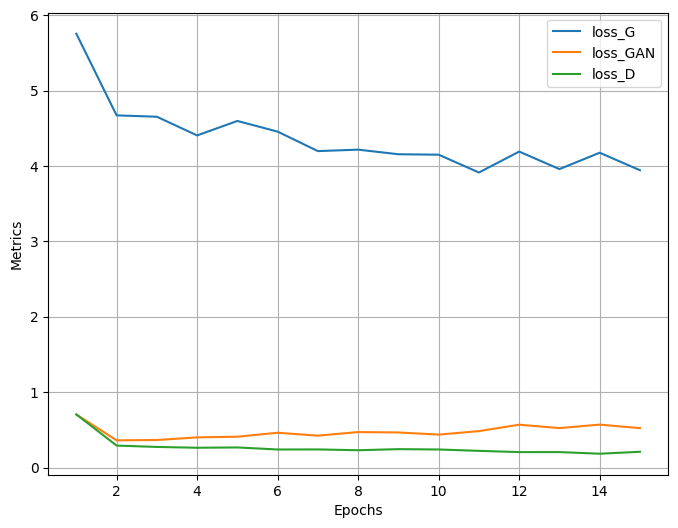

In [23]:
log.plot_epochs(['loss_G','loss_GAN', 'loss_D'])

In [24]:
# Save the weights of the generator G_AB
torch.save(G_AB.state_dict(), "G_AB_weights.pth")

# Save the weights of the generator G_BA
torch.save(G_BA.state_dict(), "G_BA_weights.pth")

# Save the weights of the discriminator D_A
torch.save(D_A.state_dict(), "D_A_weights.pth")

# Save the weights of the discriminator D_B
torch.save(D_B.state_dict(), "D_B_weights.pth")


In [25]:
# Load the pre-trained weights 

G_AB.load_state_dict(torch.load("G_AB_weights.pth", map_location=device))
G_BA.load_state_dict(torch.load("G_BA_weights.pth", map_location=device))


<All keys matched successfully>

In [29]:
# Pre-processing the custom image

from PIL import Image
import torch
import torchvision.transforms as transforms
import matplotlib.pyplot as plt

def preprocess_image(image, image_size):
    # Define the transformation
    transform = transforms.Compose([
        transforms.Resize((image_size, image_size)),  # Resize to 256x256
        transforms.ToTensor(),  # Convert to tensor
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),  # Normalize
    ])

    # Display the original image
    plt.imshow(image)
    plt.title('Original Image')
    plt.axis('off')
    plt.show()

    # Apply the transformation
    image = transform(image).unsqueeze(0)  # Add batch dimension

    return image






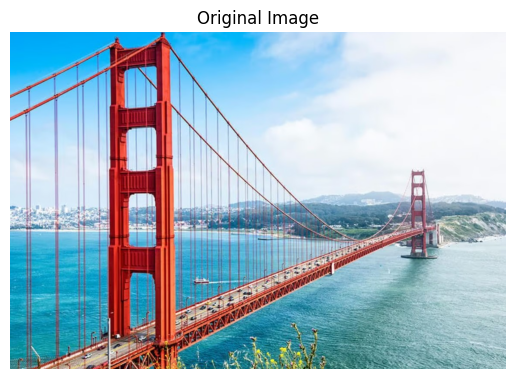

In [35]:
img = Image.open('SF.jpg')
image_size = 256
input_image = preprocess_image(img, image_size)

In [36]:
import torch


input_image_size = input_image.size()
print("Input image size:", input_image_size)


Input image size:
torch.Size([1, 3, 256, 256])

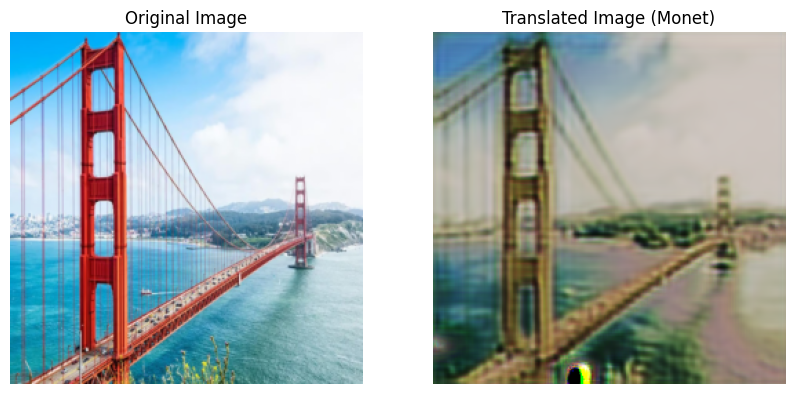

In [37]:
import torch
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

# Set model to evaluation mode
G_BA.eval()

real_B = input_image
real_B = real_B.to(device)

# Translate the input image using the CycleGAN model
fake_A = G_BA(real_B)

# Move the tensors to CPU before converting to NumPy arrays
real_B_grid = make_grid(real_B.cpu(), normalize=True)
fake_A_grid = make_grid(fake_A.cpu(), normalize=True)

# Display the images
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(real_B_grid.permute(1, 2, 0).numpy())
plt.title('Original Image')
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(fake_A_grid.permute(1, 2, 0).numpy())
plt.title('Translated Image (Monet)')
plt.axis('off')
plt.show()
